# 1.Framing the problem statement
Here,we are trying to predict the house price to make a good investment and also to mark which houses are over-rated.
Target variable is **SalePrice**

# 2. Data Analysis
Here,we will analyse the dataset.The different steps are below:

*   Step 1:Hypothesis Testing 
*   Step 2:EDA(univariate/Bivariate)
*   Step 3:Missing data
*   Step 4:Outlier
*   Step 5:Categorical data


In [1]:
# step 1: Hypothesis testing

# Null Hypothesis - there is no relationship between target and predictor
# Alternate Hypothesis - there is some relationship between target and predictor

# import the libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# import dataset
data = pd.read_csv('houseprice.csv')
print('data shape:',data.shape)
print('data columns:',data.columns)

# get the categorical columns
catCols = data.select_dtypes('object').columns
print('categorical columns:',catCols,len(catCols))

# get the numerical columns
numCols = data.select_dtypes('number').columns
print('numeric columns:',numCols,len(numCols))

# we will carry out z-test on the numeric columns to observe their probable impact on the target
from statsmodels.stats import weightstats as stests

significant_numCols,in_significant_numCols = [],[]
for i in numCols:
  if i != 'SalePrice':#as SalePrice is  target variable
    p_val = stests.ztest(data[i],data.SalePrice) 
    p_val = p_val[1]
    print('column:',i,',p-val:',p_val)
    if p_val < 0.05 :
      status = 'Reject Null Hypothesis,significant predictor'
      print(status)
      print("-------------------------------------------------")
      significant_numCols.append(i)
    else:
      status = 'Accept Null Hypothesis,insignificant predictor'
      in_significant_numCols.append(i)
      print(status)
      print("-------------------------------------------------")

print('significant numeric columns:',significant_numCols,len(significant_numCols))
print('In-significant numeric columns:',in_significant_numCols,len(in_significant_numCols))

# we will carry out chi-square test on the categorical columns to observe their probable impact on the target
from scipy.stats import chi2_contingency


significant_catCols,in_significant_catCols = [],[]
for i in catCols:
  stat,p_val,dof,ex = chi2_contingency(pd.crosstab(data[i],data.SalePrice))
  print('column:',i,',p-val:',p_val)
  if p_val < 0.05 :
    status = 'Reject Null Hypothesis,significant predictor'
    print(status)
    print("-------------------------------------------------")
    significant_catCols.append(i)
  else:
    status = 'Accept Null Hypothesis,insignificant predictor'
    in_significant_catCols.append(i)
    print(status)
    print("-------------------------------------------------")

print('significant categorical columns:',significant_catCols,len(significant_catCols))
print('In-significant categorical columns:',in_significant_catCols,len(in_significant_catCols))



data shape: (1460, 81)
data columns: Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig',
       'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType',
       'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd',
       'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1',
       'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating',
       'HeatingQC', 'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQu

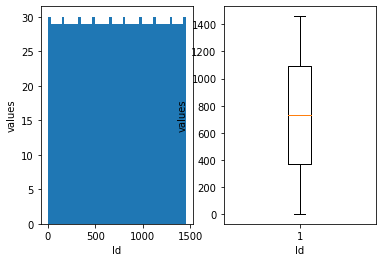

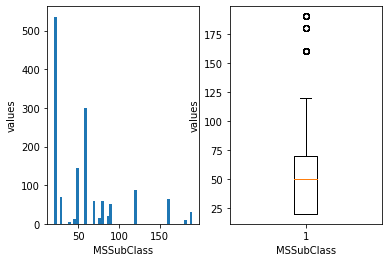

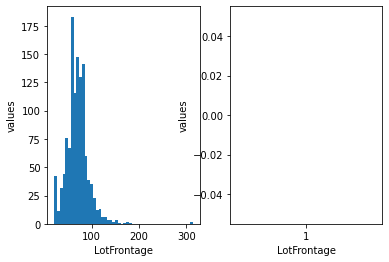

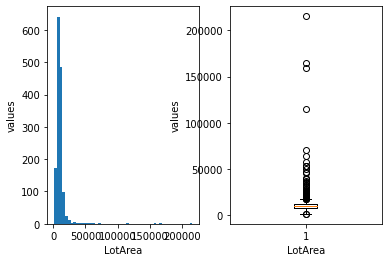

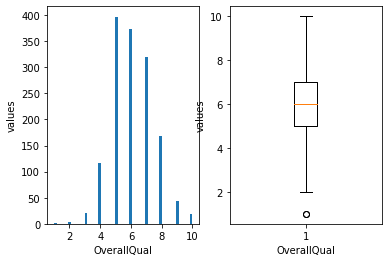

...

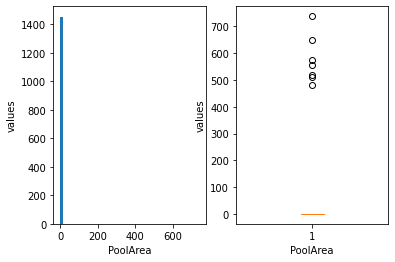

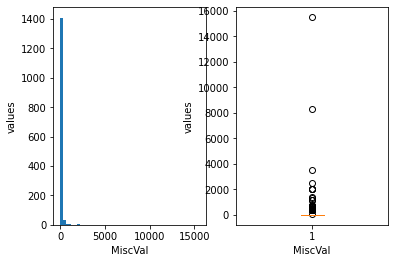

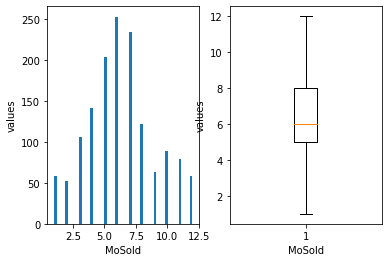

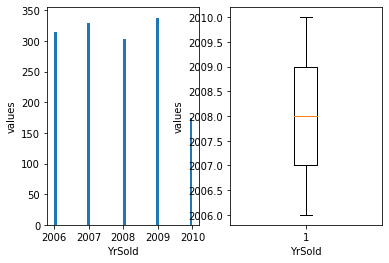

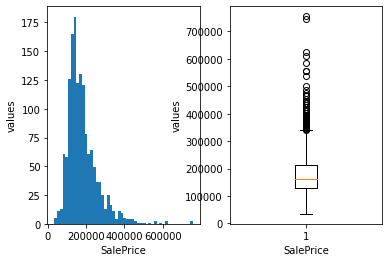

In [2]:
# Step 2:EDA(Univariate/Bivariate)

# Univariate analysis of numeric columns with histogram/distplot

for i in numCols:
  plt.subplot(1,2,1)
  plt.hist(data[i],bins =50)
  plt.xlabel(i)
  plt.ylabel('values')

  plt.subplot(1,2,2)
  plt.boxplot(data[i])
  plt.xlabel(i)
  plt.ylabel('values')

  plt.show()

In [3]:
# Univariate analysis of categorical columns with value_counts()

for i in catCols:
  print('categorical column:',i)
  print(data[i].value_counts())
  print('--------------------------------------------')



data.to_csv('data1.csv', index=False)

categorical column: MSZoning
RL         1151
RM          218
FV           65
RH           16
C (all)      10
Name: MSZoning, dtype: int64
--------------------------------------------
categorical column: Street
Pave    1454
Grvl       6
Name: Street, dtype: int64
--------------------------------------------
categorical column: Alley
Grvl    50
Pave    41
Name: Alley, dtype: int64
--------------------------------------------
categorical column: LotShape
Reg    925
IR1    484
IR2     41
IR3     10
Name: LotShape, dtype: int64
--------------------------------------------
categorical column: LandContour
Lvl    1311
Bnk      63
HLS      50
Low      36
Name: LandContour, dtype: int64
--------------------------------------------
categorical column: Utilities
AllPub    1459
NoSeWa       1
Name: Utilities, dtype: int64
--------------------------------------------
categorical column: LotConfig
Inside     1052
Corner      263
CulDSac      94
FR2          47
FR3           4
Name: LotConfig, dtype: 

                     Id  MSSubClass  LotFrontage  ...    MoSold    YrSold  SalePrice
Id             1.000000    0.011156    -0.010601  ...  0.021172  0.000712  -0.021917
MSSubClass     0.011156    1.000000    -0.386347  ... -0.013585 -0.021407  -0.084284
LotFrontage   -0.010601   -0.386347     1.000000  ...  0.011200  0.007450   0.351799
LotArea       -0.033226   -0.139781     0.426095  ...  0.001205 -0.014261   0.263843
OverallQual   -0.028365    0.032628     0.251646  ...  0.070815 -0.027347   0.790982
OverallCond    0.012609   -0.059316    -0.059213  ... -0.003511  0.043950  -0.077856
YearBuilt     -0.012713    0.027850     0.123349  ...  0.012398 -0.013618   0.522897
YearRemodAdd  -0.021998    0.040581     0.088866  ...  0.021490  0.035743   0.507101
MasVnrArea    -0.050298    0.022936     0.193458  ... -0.005965 -0.008201   0.477493
BsmtFinSF1    -0.005024   -0.069836     0.233633  ... -0.015727  0.014359   0.386420
BsmtFinSF2    -0.005968   -0.065649     0.049900  ... -0.015211  

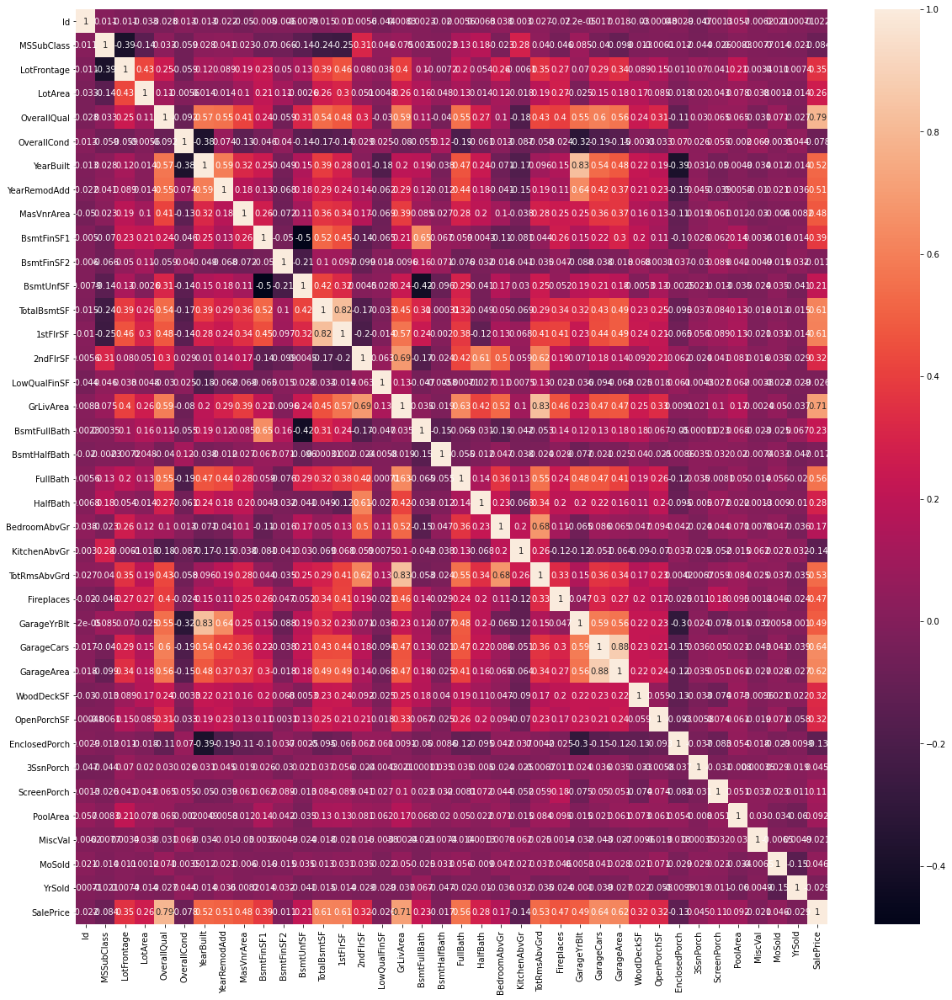

In [4]:
# Bivariate analysis of numeric columns by co-relation matrix

import seaborn as sns
matrix = data.corr()
print(matrix)

fig,ax = plt.subplots(figsize = (20,20))
sns.heatmap(matrix,annot = True)

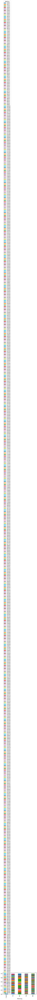

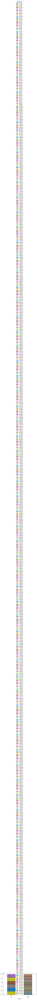

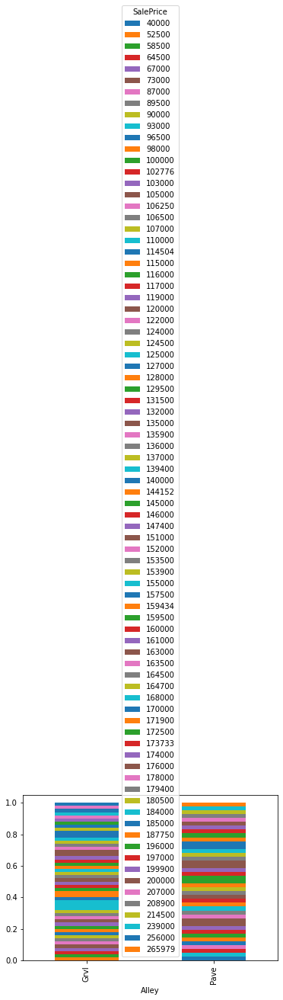

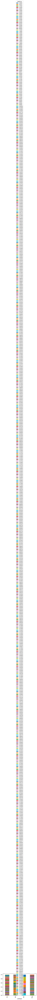

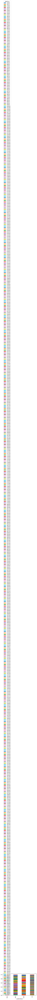

...

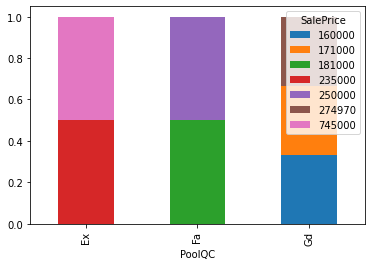

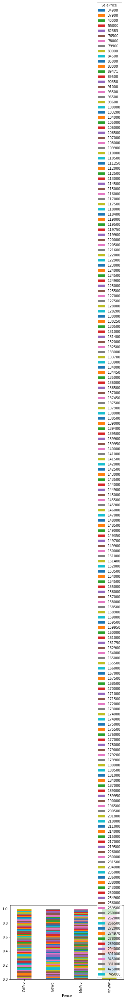

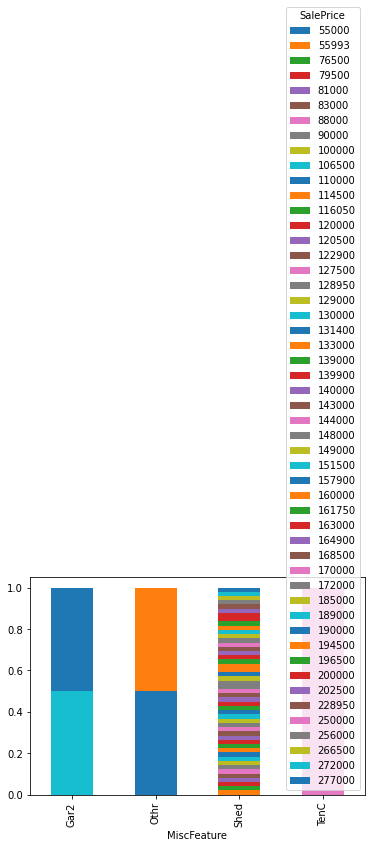

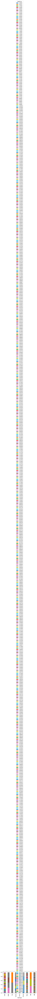

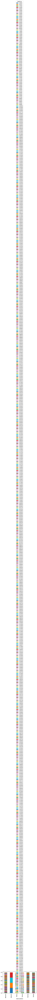

In [5]:
#  Bivariate analysis of categorical columns by crosstab -- commenting for now as its taking lot of time

for i in catCols:
  category = pd.crosstab(data[i],data['SalePrice'])
  category.div(category.sum(1).astype(float),axis=0).plot(kind='bar',stacked=True)
  plt.show()


In [6]:
# Step 3:Missing data 
# check if the null values are in the data
print(data.isnull().sum())

data.head(50)

Id                 0
MSSubClass         0
MSZoning           0
LotFrontage      259
LotArea            0
                ... 
MoSold             0
YrSold             0
SaleType           0
SaleCondition      0
SalePrice          0
Length: 81, dtype: int64


,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,...,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,...,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,...,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,...,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,...,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,...,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000
5,6,50,RL,85.0,14115,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,5,1993,1995,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,Wood,Gd,TA,No,GLQ,732,Unf,0,64,796,GasA,...,Y,SBrkr,796,566,0,1362,1,0,1,1,1,1,TA,5,Typ,0,NaN,Attchd,1993.0,Unf,2,480,TA,TA,Y,40,30,0,320,0,0,NaN,MnPrv,Shed,700,10,2009,WD,Normal,143000
6,7,20,RL,75.0,10084,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,2004,2005,Gable,CompShg,VinylSd,VinylSd,Stone,186.0,Gd,TA,PConc,Ex,TA,Av,GLQ,1369,Unf,0,317,1686,GasA,...,Y,SBrkr,1694,0,0,1694,1,0,2,0,3,1,Gd,7,Typ,1,Gd,Attchd,2004.0,RFn,2,636,TA,TA,Y,255,57,0,0,0,0,NaN,NaN,NaN,0,8,2007,WD,Normal,307000
7,8,60,RL,NaN,10382,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,7,6,1973,1973,Gable,CompShg,HdBoard,HdBoard,Stone,240.0,TA,TA,CBlock,Gd,TA,Mn,ALQ,859,BLQ,32,216,1107,GasA,...,Y,SBrkr,1107,983,0,2090,1,0,2,1,3,1,TA,7,Typ,2,TA,Attchd,1973.0,RFn,2,484,TA,TA,Y,235,204,228,0,0,0,NaN,NaN,Shed,350,11,2009,WD,Normal,200000
8,9,50,RM,51.0,6120,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,1931,1950,Gable,CompShg,BrkFace,Wd Shng,None,0.0,TA,TA,BrkTil,TA,TA,No,Unf,0,Unf,0,952,952,GasA,...,Y,FuseF,1022,752,0,1774,0,0,2,0,2,2,TA,8,Min1,2,TA,Detchd,1931.0,Unf,2,468,Fa,TA,Y,90,0,205,0,0,0,NaN,NaN,NaN,0,4,2008,WD,Abnorml,129900
9,10,190,RL,50.0,7420,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Artery,Artery,2fmCon,1.5Unf,5,6,1939,1950,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,BrkTil,TA,TA,No,GLQ,851,Unf,0,140,991,

In [7]:

# get the columns with null values
vars_with_na = [var for var in data.columns if data[var].isnull().sum()>0]

print('columns with null values:',vars_with_na,len(vars_with_na))

# get the percentage of data missing in each column
data[vars_with_na].isnull().mean()*100 

columns with null values: ['LotFrontage', 'Alley', 'MasVnrType', 'MasVnrArea', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Electrical', 'FireplaceQu', 'GarageType', 'GarageYrBlt', 'GarageFinish', 'GarageQual', 'GarageCond', 'PoolQC', 'Fence', 'MiscFeature'] 19


LotFrontage     17.739726
Alley           93.767123
MasVnrType       0.547945
MasVnrArea       0.547945
BsmtQual         2.534247
BsmtCond         2.534247
BsmtExposure     2.602740
BsmtFinType1     2.534247
BsmtFinType2     2.602740
Electrical       0.068493
FireplaceQu     47.260274
GarageType       5.547945
GarageYrBlt      5.547945
GarageFinish     5.547945
GarageQual       5.547945
GarageCond       5.547945
PoolQC          99.520548
Fence           80.753425
MiscFeature     96.301370
dtype: float64

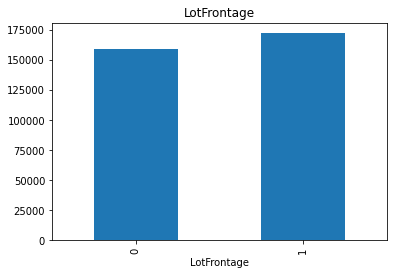

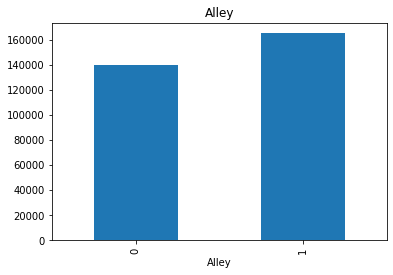

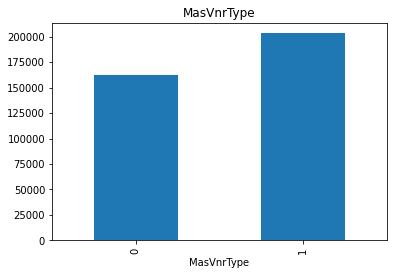

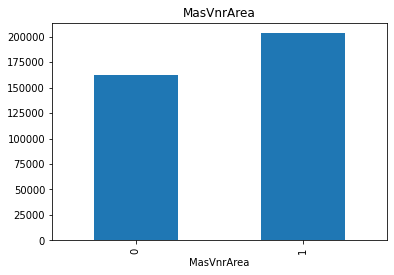

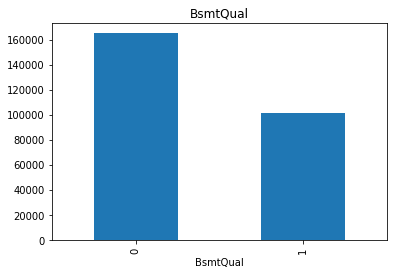

...

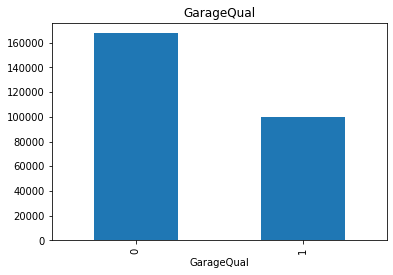

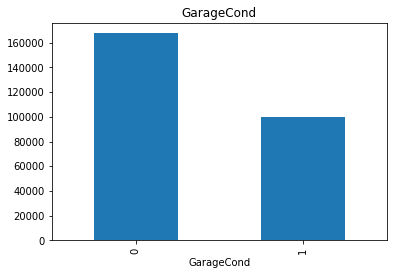

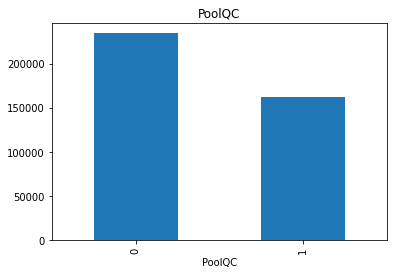

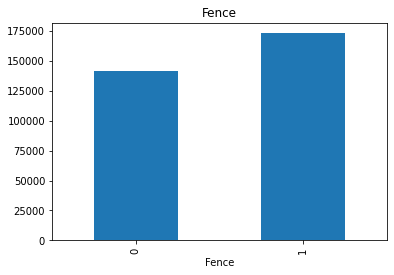

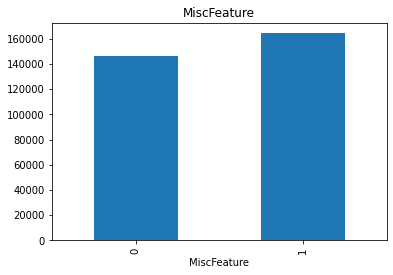

In [8]:
# visualize if there is any relationship between target and the missing value columns

def analyse_na_value(df,var):
  df = df.copy()

  # lets make a variable that shows 1 for misssing value and 0 for otherwise
  df[var] = np.where(df[var].isnull(),1,0)
  df.groupby(var)['SalePrice'].median().plot.bar()
  plt.title(var)
  plt.show()

# lets run for each columns in vars_with_na and visualise the relationship

for i in vars_with_na:
  analyse_na_value(data,i)


In [9]:
# Step 4 :Numerical data  visualization
print('numerical columns:',numCols,len(numCols))

# -> 1.visualize the numeriacl variables
data[numCols].head()

# Id is unique so we will not consider for further analysis
print('unique ids:',len(data.Id.unique()))
print('length of the dataset:',len(data))

numerical columns: Index(['Id', 'MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual',
       'OverallCond', 'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1',
       'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd',
       'Fireplaces', 'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea',
       'MiscVal', 'MoSold', 'YrSold', 'SalePrice'],
      dtype='object') 38
unique ids: 1460
length of the dataset: 1460


columns with year values ['YearBuilt', 'YearRemodAdd', 'GarageYrBlt', 'YrSold']
discrete numerical columns : ['MSSubClass', 'OverallQual', 'OverallCond', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageCars', 'PoolArea', 'MoSold'] 14


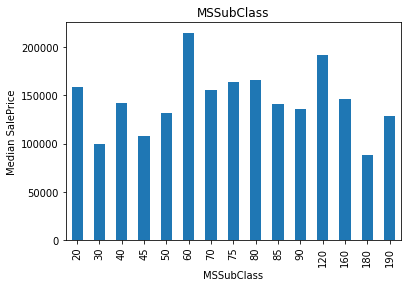

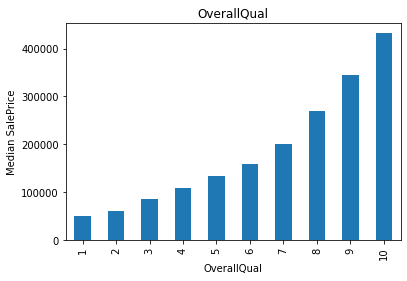

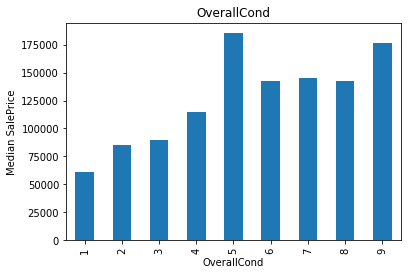

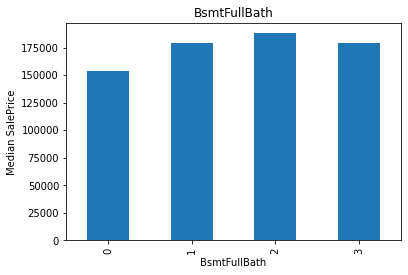

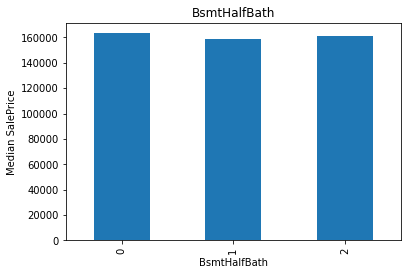

...

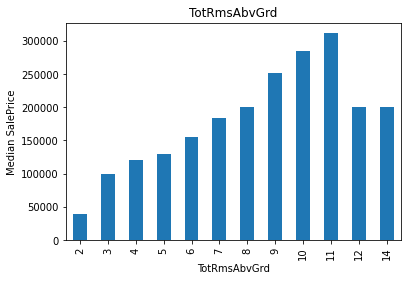

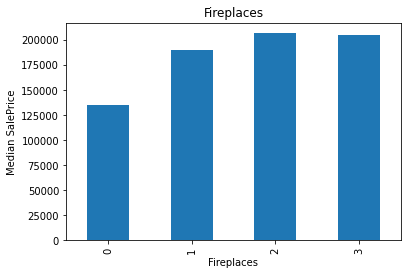

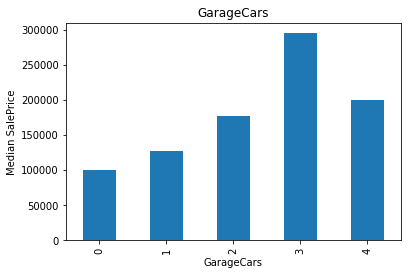

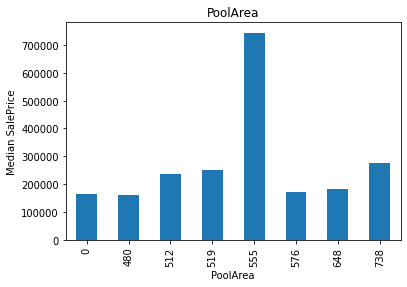

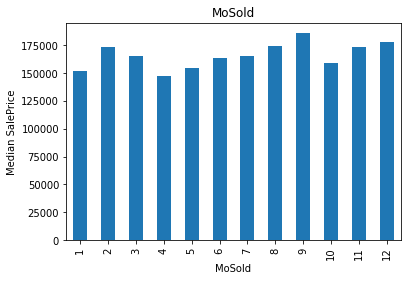

In [10]:
# -> 2.lets make list of discrete variables among the numerical columns
year_vars = [ var for var in numCols if 'Yr' in var or 'Year' in var]
print('columns with year values',year_vars)

discrete_numCols = [var for var in numCols if len(data[var].unique())<20 and var not in year_vars + ['Id']]

print('discrete numerical columns :',discrete_numCols,len(discrete_numCols))

# visualize discrete numerical columns
data[discrete_numCols].head()

# visualize their contribution to target
def analyse_discrete(df,var):
  df = df.copy()
  df.groupby(var)['SalePrice'].median().plot.bar()
  plt.title(var)
  plt.ylabel('Median SalePrice')
  plt.show()

# lets run for each columns in discrete_numCols and visualise the relationship to target

for i in discrete_numCols:
  analyse_discrete(data,i)


continuous numerical columns : ['LotFrontage', 'LotArea', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'MiscVal', 'SalePrice'] 19


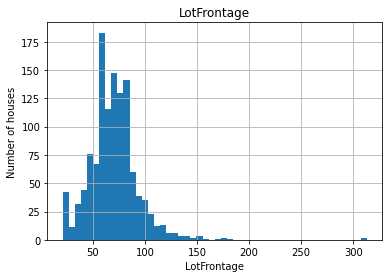

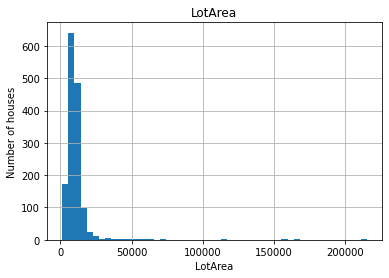

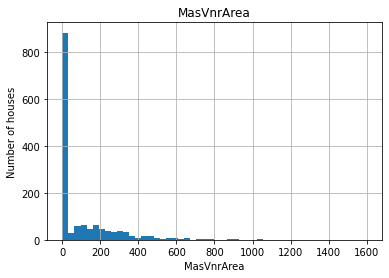

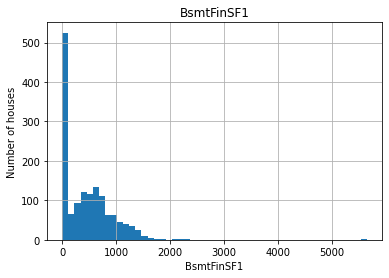

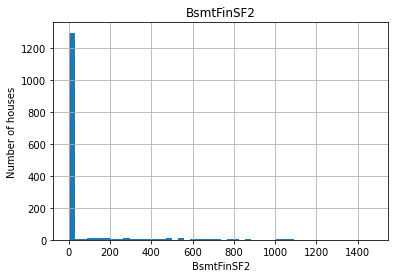

...

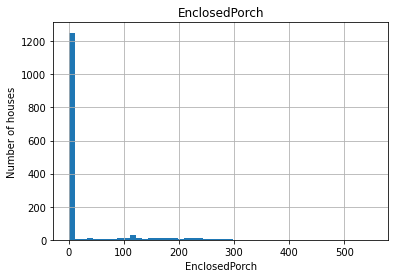

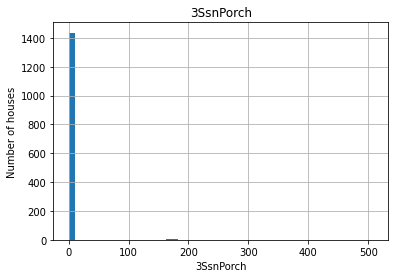

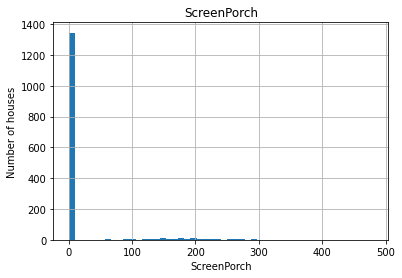

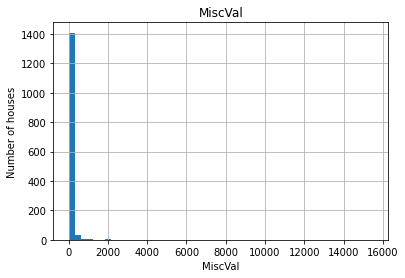

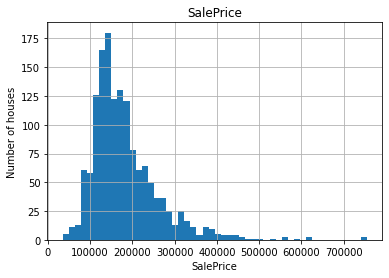

In [11]:
# -> 3.lets make list of continuous variables among the numerical columns
cont_numCols = [var for var in numCols if len(data[var].unique())>=20 and var not in year_vars + ['Id']]

print('continuous numerical columns :',cont_numCols,len(cont_numCols))

# visualize discrete numerical columns
data[cont_numCols].head()


# visualize their contribution to target
def analyse_continuous(df,var):
  df = df.copy()
  df[var].hist(bins = 50)
  plt.ylabel('Number of houses')
  plt.xlabel(var)
  plt.title(var)
  plt.show()

for var in cont_numCols:
  analyse_continuous(data,var)

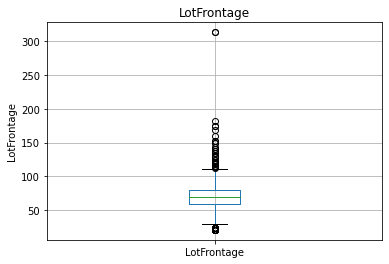

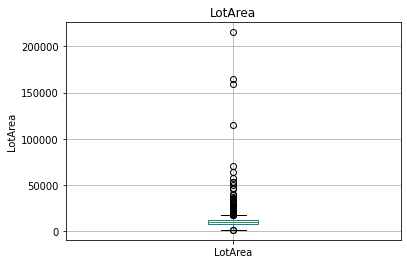

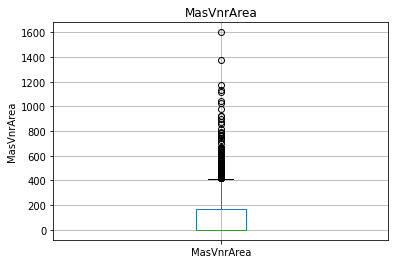

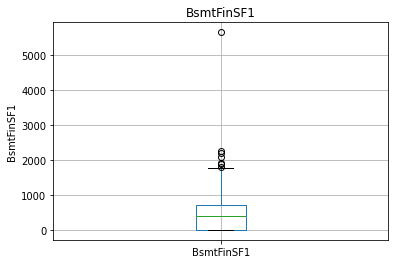

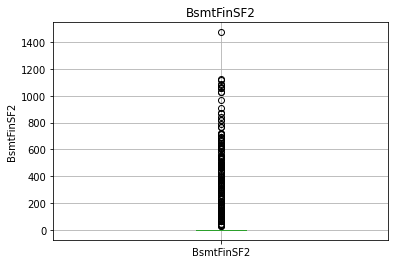

...

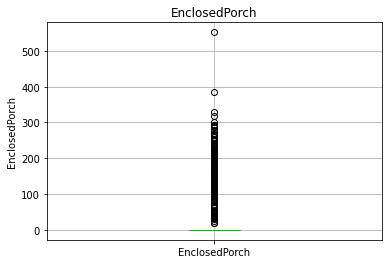

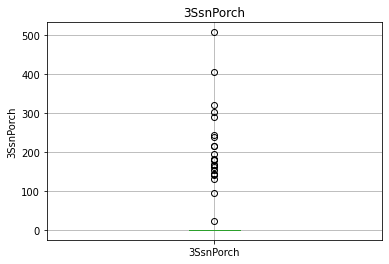

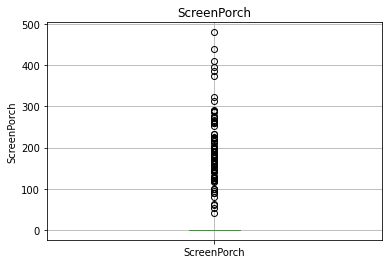

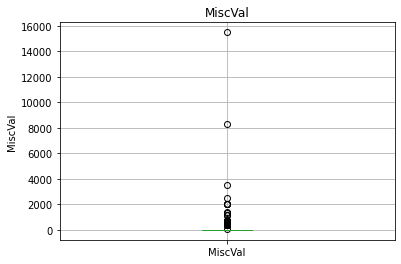

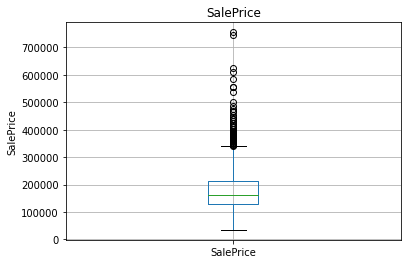

In [12]:
# Step 5 :Outliers  visualization

# we will make boxplots on the continuous numeric columns to visualize the presence of outliers

def find_outliers(df,var):
  df = df.copy()
  # if any(data[var] < 0):
  #   pass
  # else:
  #   data[var] = np.log(df[var])
  df.boxplot(column = var)
  plt.title(var)
  plt.ylabel(var)
  plt.show()

for var in cont_numCols:
  find_outliers(data,var)



In [13]:
# Step 6 :Categorical data  visualization


print('categorical columns:',catCols,len(catCols))

# -> 1.visualize the categorical variables
data[catCols].head()


categorical columns: Index(['MSZoning', 'Street', 'Alley', 'LotShape', 'LandContour', 'Utilities',
       'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2',
       'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st',
       'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation',
       'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2',
       'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual',
       'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual',
       'GarageCond', 'PavedDrive', 'PoolQC', 'Fence', 'MiscFeature',
       'SaleType', 'SaleCondition'],
      dtype='object') 43


,MSZoning,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,Heating,HeatingQC,CentralAir,Electrical,KitchenQual,Functional,FireplaceQu,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,PoolQC,Fence,MiscFeature,SaleType,SaleCondition
0,RL,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,NaN,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal
1,RL,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,Gable,CompShg,MetalSd,MetalSd,None,TA,TA,CBlock,Gd,TA,Gd,ALQ,Unf,GasA,Ex,Y,SBrkr,TA,Typ,TA,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal
2,RL,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,Mn,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,TA,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal
3,RL,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,Gable,CompShg,Wd Sdng,Wd Shng,None,TA,TA,BrkTil,TA,Gd,No,ALQ,Unf,GasA,Gd,Y,SBrkr,Gd,Typ,Gd,Detchd,Unf,TA,TA,Y,NaN,NaN,NaN,WD,Abnorml
4,RL,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,Av,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,TA,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal


In [14]:
# -> 2.cardinality of  the categorical variables
data[catCols].nunique()

MSZoning          5
Street            2
Alley             2
LotShape          4
LandContour       4
Utilities         2
LotConfig         5
LandSlope         3
Neighborhood     25
Condition1        9
Condition2        8
BldgType          5
HouseStyle        8
RoofStyle         6
RoofMatl          8
Exterior1st      15
Exterior2nd      16
MasVnrType        4
ExterQual         4
ExterCond         5
Foundation        6
BsmtQual          4
BsmtCond          4
BsmtExposure      4
BsmtFinType1      6
BsmtFinType2      6
Heating           6
HeatingQC         5
CentralAir        2
Electrical        5
KitchenQual       4
Functional        7
FireplaceQu       5
GarageType        6
GarageFinish      3
GarageQual        5
GarageCond        5
PavedDrive        3
PoolQC            3
Fence             4
MiscFeature       4
SaleType          9
SaleCondition     6
dtype: int64

In [15]:
# -> 3.analyse the rare labels in the categorical variables

def analyse_rare_vars(df,var,rare_percentage):
  df = df.copy()
  tmp = df.groupby(var)['SalePrice'].count()/len(df)

  return tmp[tmp < rare_percentage]

for i in catCols:
  print(analyse_rare_vars(data,i,0.01)) #here we,consider rare percent as 1%
  print()

MSZoning
C (all)    0.006849
Name: SalePrice, dtype: float64

Street
Grvl    0.00411
Name: SalePrice, dtype: float64

Series([], Name: SalePrice, dtype: float64)

LotShape
IR3    0.006849
Name: SalePrice, dtype: float64

Series([], Name: SalePrice, dtype: float64)

Utilities
NoSeWa    0.000685
Name: SalePrice, dtype: float64

LotConfig
FR3    0.00274
Name: SalePrice, dtype: float64

LandSlope
Sev    0.008904
Name: SalePrice, dtype: float64

Neighborhood
Blueste    0.001370
NPkVill    0.006164
Veenker    0.007534
Name: SalePrice, dtype: float64

Condition1
PosA    0.005479
RRAe    0.007534
RRNe    0.001370
RRNn    0.003425
Name: SalePrice, dtype: float64

Condition2
Artery    0.001370
Feedr     0.004110
PosA      0.000685
PosN      0.001370
RRAe      0.000685
RRAn      0.000685
RRNn      0.001370
Name: SalePrice, dtype: float64

Series([], Name: SalePrice, dtype: float64)

HouseStyle
1.5Unf    0.009589
2.5Fin    0.005479
2.5Unf    0.007534
Name: SalePrice, dtype: float64

RoofStyle
Flat

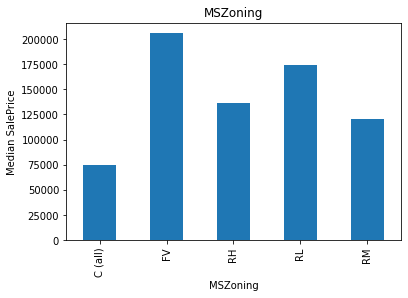

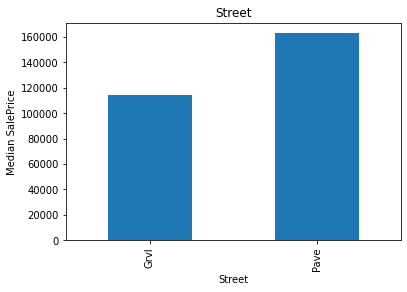

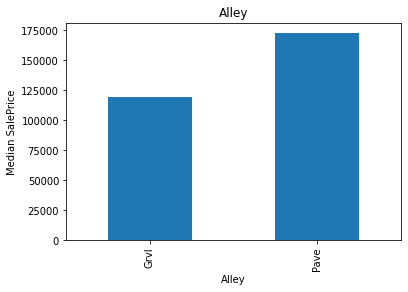

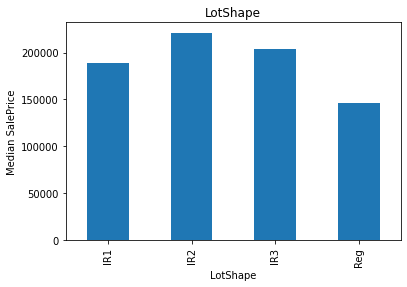

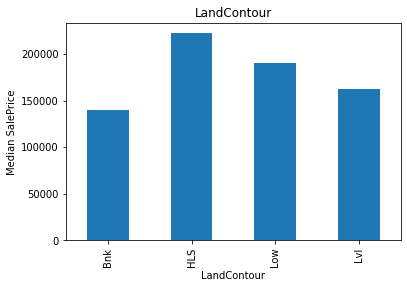

...

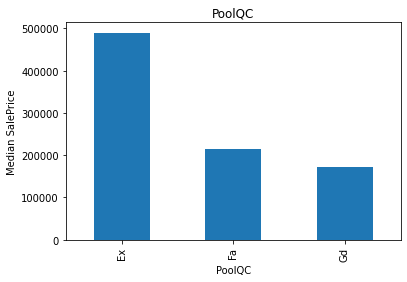

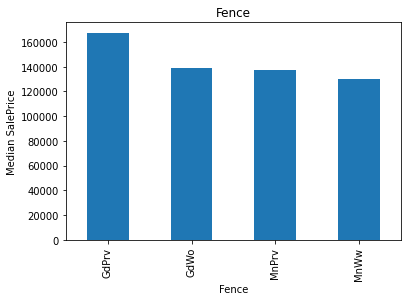

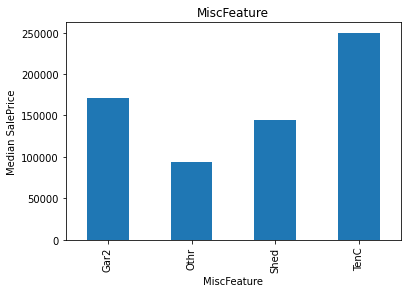

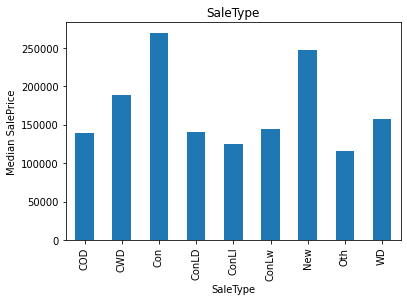

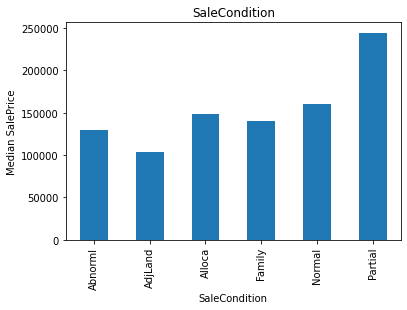

In [16]:
# -> 4.explore the relationship of various categoriacal columns with the target

for i in catCols:
  analyse_discrete(data,i)

# 3. Feature Engineering
Here,we will deal with all the problems faced above like



*   train test split
*   missing value treatment
*   temporal variables handling
*   non-guassian distributed variables
*   rare categorical labels treatment
*   encoding categorical variables
*   feature scaling








In [17]:
# -> step 1.train test split
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(data,data['SalePrice'],test_size = 0.1,random_state = 0)
print(X_train.shape,X_test.shape)


(1314, 81) (146, 81)


In [18]:
# -> step 2.missing value treatment

# get the categoriacal variable from vars_with_na
# print(vars_with_na,len(vars_with_na))
# print(data[vars_with_na].dtypes == 'object')

cat_var_with_na = [var for var in data.columns if data[var].isnull().sum()>0 and data[var].dtypes =='object']
print('categorical columns with null values',cat_var_with_na,len(cat_var_with_na))

# # visualise the missing categorical data in X_train
print(X_train[cat_var_with_na].isnull().mean()*100)

# replacing missing values with 'missing' labels
X_train[cat_var_with_na] = X_train[cat_var_with_na].fillna('Missing')
X_test[cat_var_with_na] = X_test[cat_var_with_na].fillna('Missing') 

print(X_train[cat_var_with_na].isnull().sum())
print(X_test[cat_var_with_na].isnull().sum())


categorical columns with null values ['Alley', 'MasVnrType', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Electrical', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PoolQC', 'Fence', 'MiscFeature'] 16
Alley           93.835616
MasVnrType       0.456621
BsmtQual         2.435312
BsmtCond         2.435312
BsmtExposure     2.511416
BsmtFinType1     2.435312
BsmtFinType2     2.511416
Electrical       0.076104
FireplaceQu     47.260274
GarageType       5.631659
GarageFinish     5.631659
GarageQual       5.631659
GarageCond       5.631659
PoolQC          99.543379
Fence           81.430746
MiscFeature     96.118721
dtype: float64
Alley           0
MasVnrType      0
BsmtQual        0
BsmtCond        0
BsmtExposure    0
BsmtFinType1    0
BsmtFinType2    0
Electrical      0
FireplaceQu     0
GarageType      0
GarageFinish    0
GarageQual      0
GarageCond      0
PoolQC          0
Fence           0
MiscFeature     0
dtype: int64
Alley      

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:3069: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


In [19]:
# get the numerical variable from vars_with_na

num_var_with_na = [var for var in data.columns if data[var].isnull().sum()>0 and data[var].dtypes !='object']
print('numeric columns with null values',num_var_with_na,len(num_var_with_na))

# visualise the missing categorical data in X_train
print(X_train[num_var_with_na].isnull().mean()*100)

numeric columns with null values ['LotFrontage', 'MasVnrArea', 'GarageYrBlt'] 3
LotFrontage    17.732116
MasVnrArea      0.456621
GarageYrBlt     5.631659
dtype: float64


In [20]:
# replace the numerical missing values with mode
import warnings
warnings.simplefilter(action='ignore')

for var in num_var_with_na:
  # mode = X_train[var].median()
  mode = X_train[var].mode()[0]

# creating a new column with the record of missing
  X_train[var+'_na'] = np.where(X_train[var].isnull(),1,0)
  X_test[var+'_na'] = np.where(X_test[var].isnull(), 1, 0)


# replacing missing values in train 
for var in  num_var_with_na :
  mode = X_train[var].mode()[0]
  X_train[var] = X_train[var].fillna(mode)

# replacing missing values in test
for var in  num_var_with_na :
  mode = X_train[var].mode()[0]
  X_test[var] = X_test[var].fillna(mode)   


print(X_train[num_var_with_na].isnull().sum())
print(X_test[num_var_with_na].isnull().sum())

LotFrontage    0
MasVnrArea     0
GarageYrBlt    0
dtype: int64
LotFrontage    0
MasVnrArea     0
GarageYrBlt    0
dtype: int64


In [21]:
X_train[['LotFrontage_na', 'MasVnrArea_na', 'GarageYrBlt_na']].head()

,LotFrontage_na,MasVnrArea_na,GarageYrBlt_na
930,0,0,0
656,0,0,0
45,0,0,0
1348,1,0,0
55,0,0,0


In [22]:
# -> step 3.temporal variables handling

def elapsed_years(df,var):
  df[var] = df['YrSold'] - df[var]
  return df

for var in ['YearBuilt', 'YearRemodAdd', 'GarageYrBlt']:
    X_train = elapsed_years(X_train, var)
    X_test = elapsed_years(X_test, var)

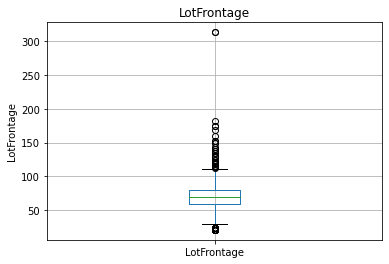

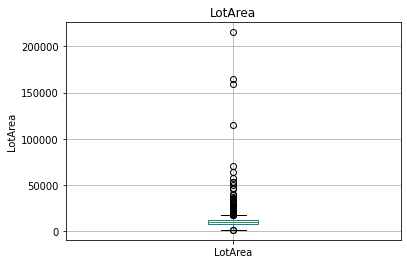

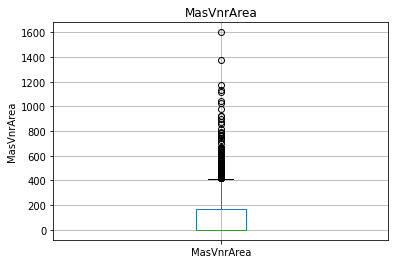

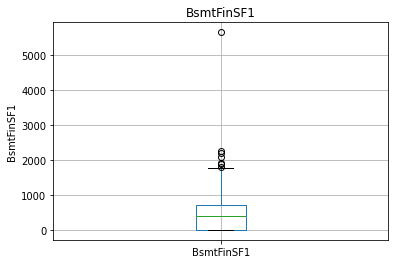

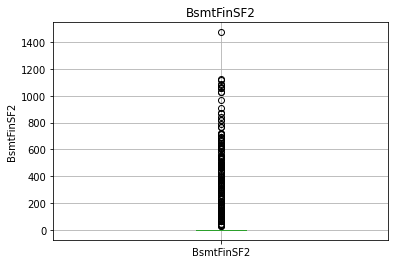

...

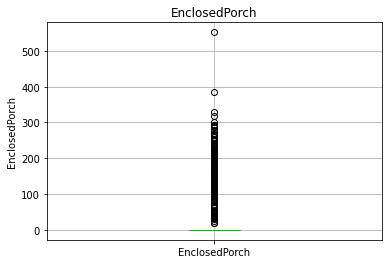

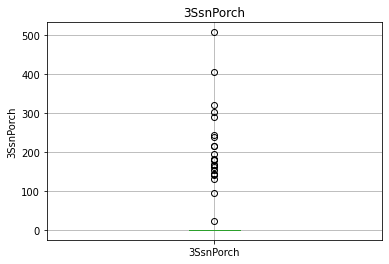

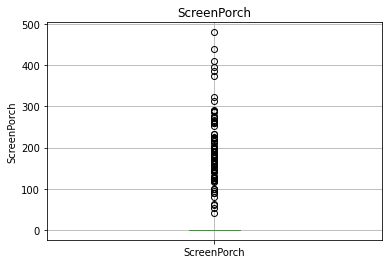

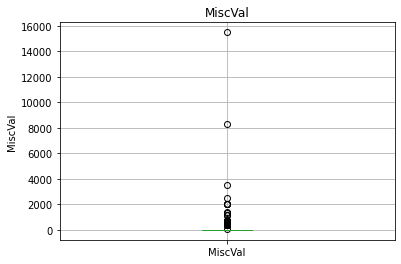

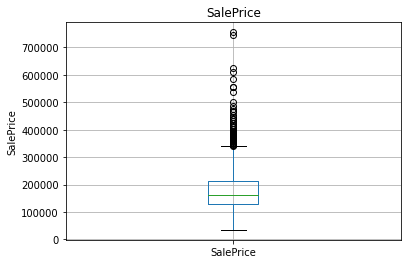

visualizing the data distribution in train data


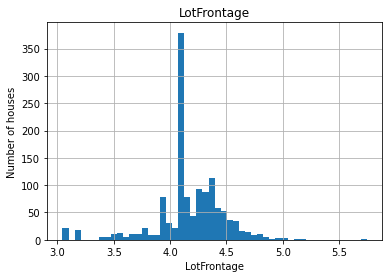

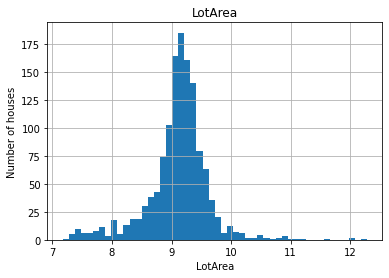

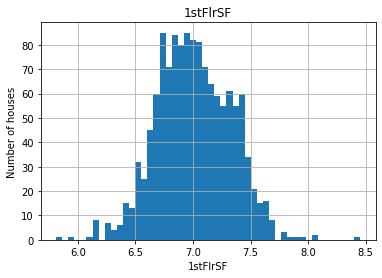

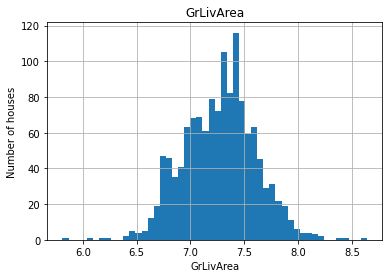

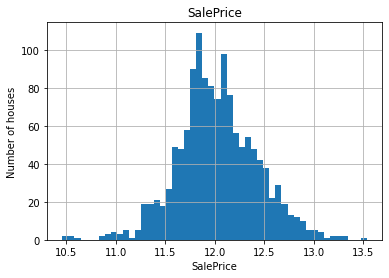

visualizing the data distribution in test data


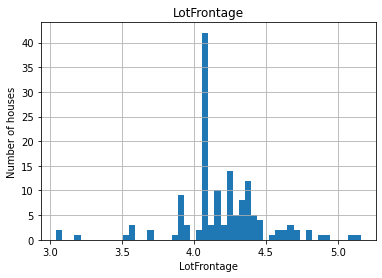

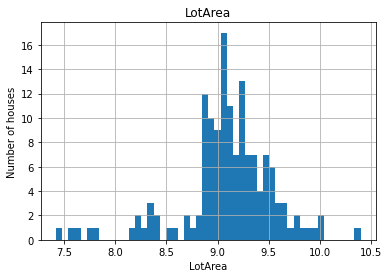

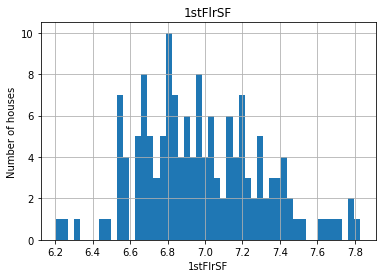

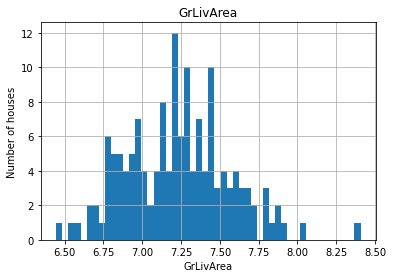

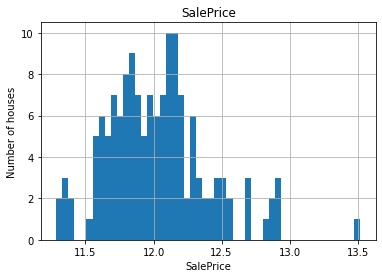

In [23]:
# -> step 4.handling outliers 
for var in cont_numCols:
  find_outliers(data,var)

# treating outliers and visualize data  in train data
print('visualizing the data distribution in train data')
for var in ['LotFrontage', 'LotArea', '1stFlrSF', 'GrLivArea', 'SalePrice']:
  X_train[var] = np.log(X_train[var])
  X_train[var].hist(bins = 50)
  plt.ylabel('Number of houses')
  plt.xlabel(var)
  plt.title(var)
  plt.show()

# treating outliers and visualize data  in train data
print('visualizing the data distribution in test data')
for var in ['LotFrontage', 'LotArea', '1stFlrSF', 'GrLivArea', 'SalePrice']:
  X_test[var] = np.log(X_test[var])
  X_test[var].hist(bins = 50)
  plt.ylabel('Number of houses')
  plt.xlabel(var)
  plt.title(var)
  plt.show()

In [24]:
# -> step 5.handling rare categorical labels

# find frequents labels
# print('categoriacl columns:',catCols,len(catCols))


cat_vars = [var for var in X_train.columns if X_train[var].dtype == 'O']
def find_frequent_labels(df, var, rare_perc):
    
    # function finds the labels that are shared by more than
    # a certain % of the houses in the dataset

    df = df.copy()

    tmp = df.groupby(var)['SalePrice'].count() / len(df)

    return tmp[tmp > rare_perc].index

print("------------------------------------")
print('cat_vars:',cat_vars,len(cat_vars))
for var in cat_vars:
    
    # find the frequent categories
    frequent_ls = find_frequent_labels(X_train, var, 0.01)
    
    # replace rare categories by the string "Rare"
    X_train[var] = np.where(X_train[var].isin(
        frequent_ls), X_train[var], 'Rare')
    
    X_test[var] = np.where(X_test[var].isin(
        frequent_ls), X_test[var], 'Rare')

------------------------------------
cat_vars: ['MSZoning', 'Street', 'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual', 'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive', 'PoolQC', 'Fence', 'MiscFeature', 'SaleType', 'SaleCondition'] 43


(1314, 84) (146, 84)


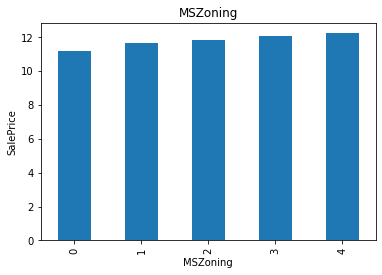

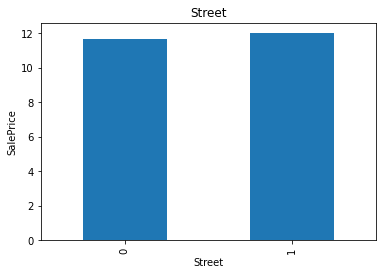

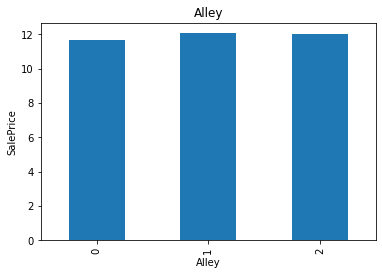

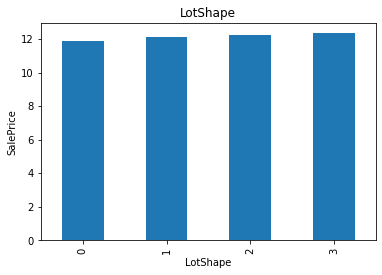

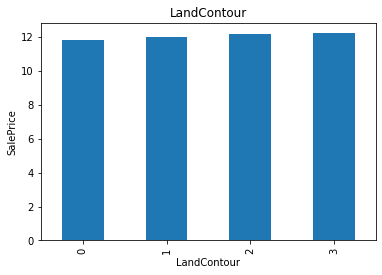

...

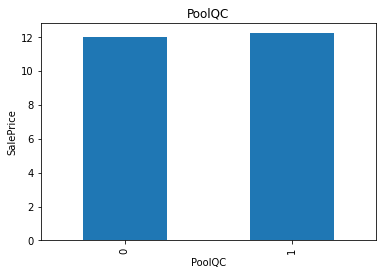

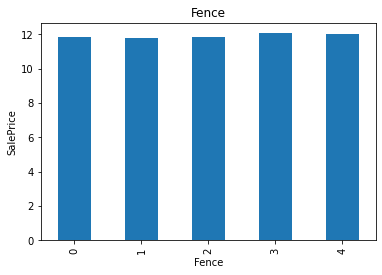

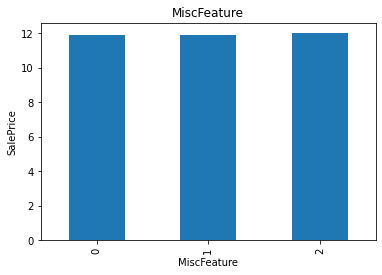

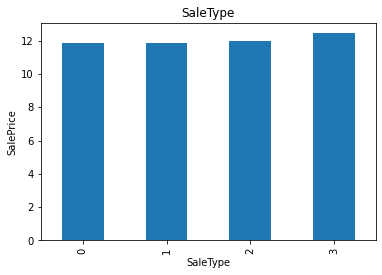

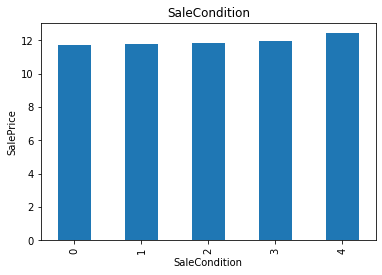

In [25]:
# -> step 5.Encoding categorical variables
def replace_categories(train, test, var, target):

    # order the categories in a variable from that with the lowest
    # house sale price, to that with the highest
    ordered_labels = train.groupby([var])[target].mean().sort_values().index

    # create a dictionary of ordered categories to integer values
    ordinal_label = {k: i for i, k in enumerate(ordered_labels, 0)}

    # use the dictionary to replace the categorical strings by integers
    train[var] = train[var].map(ordinal_label)
    test[var] = test[var].map(ordinal_label)

for var in cat_vars:
    replace_categories(X_train, X_test, var, 'SalePrice')

print(X_train.shape,X_test.shape)

# between labels and target

def analyse_vars(df, var):
    
    # function plots median house sale price per encoded
    # category
    
    df = df.copy()
    df.groupby(var)['SalePrice'].median().plot.bar()
    plt.title(var)
    plt.ylabel('SalePrice')
    plt.show()
    
for var in cat_vars:
    analyse_vars(X_train, var)

In [26]:
# -> step 6.Feature Scaling

X_train.to_csv('xtrain.csv', index=False)
X_test.to_csv('xtest.csv', index=False)
print(X_train.head())
# print(np.isnan(X_train.any()))

# print(np.all(np.isfinite(data)))

from sklearn.preprocessing import MinMaxScaler
train_vars = [var for var in X_train.columns if var not in ['Id', 'SalePrice']]

# create scaler
scaler = MinMaxScaler()

#  fit  the scaler to the train set
scaler.fit(X_train[train_vars]) 

# transform the train and test set
X_train[train_vars] = scaler.transform(X_train[train_vars])

X_test[train_vars] = scaler.transform(X_test[train_vars])


        Id  MSSubClass  MSZoning  ...  LotFrontage_na  MasVnrArea_na  GarageYrBlt_na
930    931          20         3  ...               0              0               0
656    657          20         3  ...               0              0               0
45      46         120         3  ...               0              0               0
1348  1349          20         3  ...               1              0               0
55      56          20         3  ...               0              0               0

[5 rows x 84 columns]


In [27]:
X_train.to_csv('xtrain.csv', index=False)
X_test.to_csv('xtest.csv', index=False)

# 4. Feature Selection
for feature selection ,we will choose Lasso regression as it has the capability to shrink some of the coefficients to 0 .

In [28]:
from sklearn.linear_model import Lasso
from sklearn.feature_selection import SelectFromModel
print(X_train.head())

        Id  MSSubClass  MSZoning  ...  LotFrontage_na  MasVnrArea_na  GarageYrBlt_na
930    931    0.000000      0.75  ...             0.0            0.0             0.0
656    657    0.000000      0.75  ...             0.0            0.0             0.0
45      46    0.588235      0.75  ...             0.0            0.0             0.0
1348  1349    0.000000      0.75  ...             1.0            0.0             0.0
55      56    0.000000      0.75  ...             0.0            0.0             0.0

[5 rows x 84 columns]


In [29]:
y_train = X_train['SalePrice']
y_test = X_test['SalePrice']

# drop unnecessary variables from our training and testing sets
X_train.drop(['Id', 'SalePrice'], axis=1, inplace=True)
X_test.drop(['Id', 'SalePrice'], axis=1, inplace=True)

# remember to set the seed, the random state in this function
sel_ = SelectFromModel(Lasso(alpha=0.005, random_state=0))

# train Lasso model and select features
sel_.fit(X_train, y_train)

SelectFromModel(estimator=Lasso(alpha=0.005, copy_X=True, fit_intercept=True,
                                max_iter=1000, normalize=False, positive=False,
                                precompute=False, random_state=0,
                                selection='cyclic', tol=0.0001,
                                warm_start=False),
                max_features=None, norm_order=1, prefit=False, threshold=None)

In [30]:
sel_.get_support()

array([ True,  True, False, False, False, False, False, False, False,
       False, False,  True, False, False, False, False,  True,  True,
       False,  True,  True, False, False, False,  True, False, False,
       False, False,  True, False,  True, False, False, False, False,
       False, False, False,  True,  True, False,  True, False, False,
        True,  True, False, False, False, False, False,  True, False,
       False,  True,  True,  True, False,  True,  True, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False])

In [31]:
# let's print the number of total and selected features

# this is how we can make a list of the selected features
selected_feats = X_train.columns[(sel_.get_support())]

# let's print some stats
print('total features: {}'.format((X_train.shape[1])))
print('selected features: {}'.format(len(selected_feats)))
print('features with coefficients shrank to zero: {}'.format(
    np.sum(sel_.estimator_.coef_ == 0)))

total features: 82
selected features: 22
features with coefficients shrank to zero: 60


In [32]:
# print the selected features
selected_feats

Index(['MSSubClass', 'MSZoning', 'Neighborhood', 'OverallQual', 'OverallCond',
       'YearRemodAdd', 'RoofStyle', 'MasVnrType', 'BsmtQual', 'BsmtExposure',
       'HeatingQC', 'CentralAir', '1stFlrSF', 'GrLivArea', 'BsmtFullBath',
       'KitchenQual', 'Fireplaces', 'FireplaceQu', 'GarageType',
       'GarageFinish', 'GarageCars', 'PavedDrive'],
      dtype='object')

In [33]:
pd.Series(selected_feats).to_csv('selected_features.csv', index=False)

In [34]:
# model building

from sklearn.linear_model import Lasso

# to evaluate the model
from sklearn.metrics import mean_squared_error, r2_score
from math import sqrt

features = pd.read_csv('selected_features.csv')
features = features['0'].to_list() 
features = features + ['LotFrontage'] 
print(features)

['MSSubClass', 'MSZoning', 'Neighborhood', 'OverallQual', 'OverallCond', 'YearRemodAdd', 'RoofStyle', 'MasVnrType', 'BsmtQual', 'BsmtExposure', 'HeatingQC', 'CentralAir', '1stFlrSF', 'GrLivArea', 'BsmtFullBath', 'KitchenQual', 'Fireplaces', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageCars', 'PavedDrive', 'LotFrontage']


# Towards Machine Learning modelling:

In [35]:
# building the model
#reduce the train and test set to the selected features

X_train = X_train[features]
X_test = X_test[features]

# Regularised linear regression: Lasso
# set up the model
# remember to set the random_state / seed

lin_model = Lasso(alpha=0.005, random_state=0)

# train the model

lin_model.fit(X_train, y_train)

# Regularised linear regression: Lasso
# set up the model
# remember to set the random_state / seed

lin_model = Lasso(alpha=0.005, random_state=0)

# train the model

lin_model.fit(X_train, y_train)
# make predictions for train set
pred = lin_model.predict(X_train)

# determine mse and rmse
print('train mse: {}'.format(int(
    mean_squared_error(np.exp(y_train), np.exp(pred)))))
print('train rmse: {}'.format(int(
    sqrt(mean_squared_error(np.exp(y_train), np.exp(pred))))))
print('train r2: {}'.format(
    r2_score(np.exp(y_train), np.exp(pred))))
print()


train mse: 1087435415
train rmse: 32976
train r2: 0.825838453543116



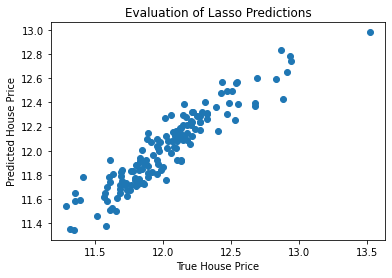

In [36]:
# let's evaluate our predictions respect to the real sale price
plt.scatter(y_test, lin_model.predict(X_test))
plt.xlabel('True House Price')
plt.ylabel('Predicted House Price')
plt.title('Evaluation of Lasso Predictions')

print()

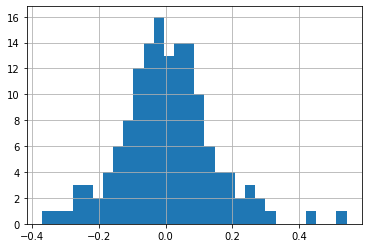

In [37]:
# let's evaluate the distribution of the errors: 
# they should be fairly normally distributed

errors = y_test - lin_model.predict(X_test)
errors.hist(bins=30)

Text(0.5, 1.0, 'Feature Importance')

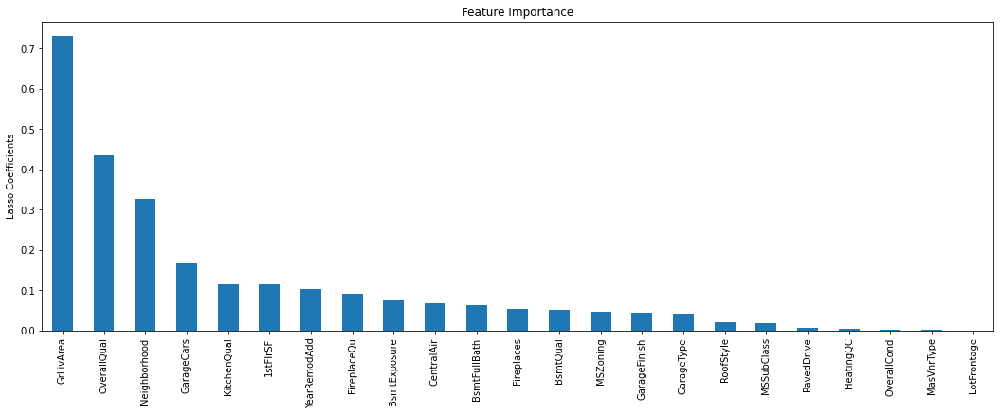

In [38]:
# Finally, just for fun, let's look at the feature importance

importance = pd.Series(np.abs(lin_model.coef_.ravel()))
importance.index = features
importance.sort_values(inplace=True, ascending=False)
importance.plot.bar(figsize=(18,6))
plt.ylabel('Lasso Coefficients')
plt.title('Feature Importance')